In [93]:
import numpy as np # i literally only used this to transpose the images lul
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torchvision
import torch.utils.data

In [117]:
# data directory
directory = "/Users/andyj/Downloads/bird_images/"

dataset = torchvision.datasets.ImageFolder(root=directory,
                           transform=torchvision.transforms.Compose([
                               torchvision.transforms.Resize(64),
                               torchvision.transforms.CenterCrop(64),
                               torchvision.transforms.ToTensor(),
                               torchvision.transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

img_dataloader = torch.utils.data.DataLoader(dataset, batch_size=64,
                                         shuffle=True, num_workers=0) # num_workers = 0 because windows is a ******

print("IMAGES LOADED")

IMAGES LOADED


In [127]:
# Generator Definition
class Generator(torch.nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = 1
        self.main = torch.nn.Sequential(
            torch.nn.ConvTranspose2d(128, 512, 4, 1, 0, bias=False),
            torch.nn.BatchNorm2d(512),
            torch.nn.ReLU(True),
            
            torch.nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            torch.nn.BatchNorm2d(256),
            torch.nn.ReLU(True),
            
            torch.nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            torch.nn.BatchNorm2d(128),
            torch.nn.ReLU(True),
            
            torch.nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            torch.nn.BatchNorm2d(64),
            torch.nn.ReLU(True),
            
            torch.nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            torch.nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [128]:

# Discriminator Definition
class Discriminator(torch.nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        
        self.ngpu = 1
        self.main = torch.nn.Sequential(
            
            torch.nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            torch.nn.LeakyReLU(0.2, inplace=True),
            
            torch.nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            torch.nn.BatchNorm2d(128),
            torch.nn.LeakyReLU(0.2, inplace=True),
            
            torch.nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            torch.nn.BatchNorm2d(256),
            torch.nn.LeakyReLU(0.2, inplace=True),
            
            torch.nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            torch.nn.BatchNorm2d(512),
            torch.nn.LeakyReLU(0.2, inplace=True),
            
            torch.nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            torch.nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [129]:
device = torch.device("cpu") 

# initializing our models

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
netD = Discriminator(1).to(device)
netG = Generator(1).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

print("generator and discriminator weights initialized")

generator and discriminator weights initialized


In [130]:
loss = torch.nn.BCELoss()
optimizerD = torch.optim.Adam(netD.parameters(), lr=0.001, betas=(0.4, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=0.0002, betas=(0.4, 0.999))

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

Starting Training Loop...
 batch #: 0

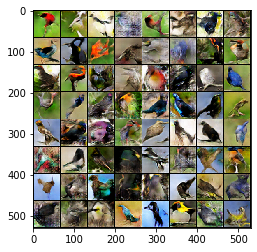

Epoch: [0/7], Batch: [0/617], DisLoss: 0.5811537504196167, GenLoss: 5.197521209716797, D(x): 0.8975749015808105
 batch #: 100

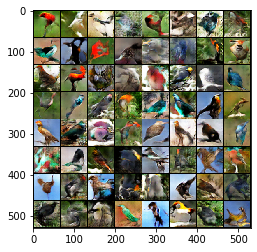

Epoch: [0/7], Batch: [100/617], DisLoss: 0.35194122791290283, GenLoss: 6.148758411407471, D(x): 0.9860284328460693
 batch #: 189

In [ ]:
print("Starting Training Loop...")

num_epochs = 7 # epic

count = 0

fixed_noise = torch.randn(64, 128, 1, 1, device=device)

for epoch in range(num_epochs):
    for i, data in enumerate(img_dataloader, 0):
        
        # pog we can tell how fast it's going!!
        print("\r", "batch #: " + str(i), end="")

        # 1. training the discriminator
        # giving it real images
        netD.zero_grad()
        real_cpu = data[0].to(device)
        label = torch.full((64,), 1., dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = loss(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # giving it fake images mwahahaha
        noise = torch.randn(64, 128, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(0.) # tis a fake batch so we label it as '0', which means fake
        output = netD(fake.detach()).view(-1)
        errD_fake = loss(output, label)
        errD_fake.backward()
        
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake  # calculate the back gradient
        optimizerD.step() # update discriminator
        
        # 2. training generator
        netG.zero_grad()
        label.fill_(1.)
        output = netD(fake).view(-1)
        errG = loss(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 100 == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img = torchvision.utils.make_grid(fake, padding=2, normalize=True)
            
            # checking the images
            plt.figure()
            show = plt.imshow(np.transpose(img,(1,2,0)))
            plt.show()
            
            print("Epoch: [{0}/{1}], Batch: [{2}/{3}], DisLoss: {4}, GenLoss: {5}, D(x): {6}"
                  .format(epoch, num_epochs, i, len(img_dataloader), errD.item(), errG.item(), D_x))
            
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (count % 100 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img = torchvision.utils.make_grid(fake, padding=2, normalize=True)
            img_list.append(img)
            
        count += 1

Animation size has reached 21501975 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


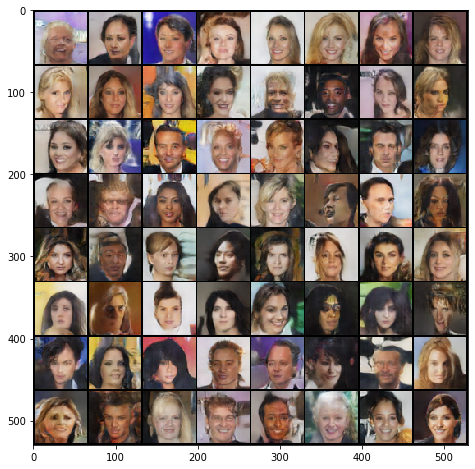

In [13]:
from IPython.display import HTML
import matplotlib.animation as animation

fig = plt.figure(figsize=(8,8))
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

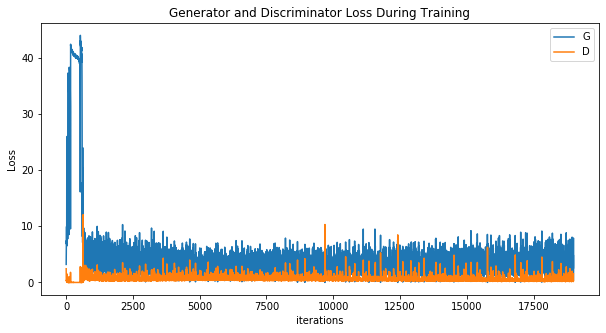

In [14]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [21]:
torch.save(netG.state_dict(), "GAN_celeb.pth")